## <center> **ML for Monkeys Regression** </center>


In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
df = pd.read_csv("./Assg_1/winequality-red.csv") ## The Original Data
df_test_white =  pd.read_csv("./Assg_1/winequality-white.csv") ## Extra Data

In [6]:
df.head()

,"fixed acidity;""volatile acidity"";""citric acid"";""residual sugar"";""chlorides"";""free sulfur dioxide"";""total sulfur dioxide"";""density"";""pH"";""sulphates"";""alcohol"";""quality"""
0,7.4;0.7;0;1.9;0.076;11;34;0.9978;3.51;0.56;9.4;5
1,7.8;0.88;0;2.6;0.098;25;67;0.9968;3.2;0.68;9.8;5
2,7.8;0.76;0.04;2.3;0.092;15;54;0.997;3.26;0.65;...
3,11.2;0.28;0.56;1.9;0.075;17;60;0.998;3.16;0.58...
4,7.4;0.7;0;1.9;0.076;11;34;0.9978;3.51;0.56;9.4;5


In [7]:
df_test_white.head()

,"fixed acidity;""volatile acidity"";""citric acid"";""residual sugar"";""chlorides"";""free sulfur dioxide"";""total sulfur dioxide"";""density"";""pH"";""sulphates"";""alcohol"";""quality"""
0,7;0.27;0.36;20.7;0.045;45;170;1.001;3;0.45;8.8;6
1,6.3;0.3;0.34;1.6;0.049;14;132;0.994;3.3;0.49;9...
2,8.1;0.28;0.4;6.9;0.05;30;97;0.9951;3.26;0.44;1...
3,7.2;0.23;0.32;8.5;0.058;47;186;0.9956;3.19;0.4...
4,7.2;0.23;0.32;8.5;0.058;47;186;0.9956;3.19;0.4...


#### Obseravtions: The data is numeric, however all the data is stored in a single column separated by ";". Hence, we should separate the data into columns.

In [8]:
## Splitting the features into separate columns
split_data = df['fixed acidity;"volatile acidity";"citric acid";"residual sugar";"chlorides";"free sulfur dioxide";"total sulfur dioxide";"density";"pH";"sulphates";"alcohol";"quality"'].str.split(";")
data = split_data.to_list()

## Converting the data to numeric form
for j in range(0,len(data)):
    for i in range(0,len(data[j])):
        data[j][i] = float(data[j][i])

## Making a new pandas data-frame
names = ["fixed acidity","volatile acidity","citric acid","residual sugar","chlorides","free sulfur dioxide","total sulfur dioxide","density","pH","sulphates","alcohol","quality"]
df = pd.DataFrame(data, columns=names)

In [9]:
## Doing the same things for the test data-set (White)

## Splitting the features into separate columns
split_data = df_test_white['fixed acidity;"volatile acidity";"citric acid";"residual sugar";"chlorides";"free sulfur dioxide";"total sulfur dioxide";"density";"pH";"sulphates";"alcohol";"quality"'].str.split(";")
data = split_data.to_list()

## Converting the data to numeric form
for j in range(0,len(data)):
    for i in range(0,len(data[j])):
        data[j][i] = float(data[j][i])

## Making a new pandas data-frame
names = ["fixed acidity","volatile acidity","citric acid","residual sugar","chlorides","free sulfur dioxide","total sulfur dioxide","density","pH","sulphates","alcohol","quality"]
df_test_white = pd.DataFrame(data, columns=names)


In [10]:
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5.0
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5.0
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5.0
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6.0
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5.0


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   float64
dtypes: float64(12)
memory usage: 150.0 KB


#### Obseravtions: Good! Now, the data is in the required format and we can proceed with further pre-processign of the data and it's visualisation

#### For this problem, quality is the target variable and rest variables are the features. For moving further, we split the given data into train and test datasets.

## Train-Test Splitting

In [12]:
## Separating the features and the target variables

features = ["fixed acidity","volatile acidity","citric acid","residual sugar","chlorides","free sulfur dioxide","total sulfur dioxide","density","pH","sulphates","alcohol"]

X = df[features]
y = df["quality"]

In [13]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X , y , test_size = 0.2) # We keep 20 percent of the data for testing

## Data Pre-Processing and Visulisation

In [14]:
for col in X_train.columns.values:
    list_vals = pd.unique(X_train[col])
    print("This feature", col,"is of the type", str(X_train[col].dtypes),"and has", str(len(list_vals)), "unique values and", str(np.isnan(list_vals).sum()), "null values")


This feature fixed acidity is of the type float64 and has 93 unique values and 0 null values
This feature volatile acidity is of the type float64 and has 134 unique values and 0 null values
This feature citric acid is of the type float64 and has 77 unique values and 0 null values
This feature residual sugar is of the type float64 and has 87 unique values and 0 null values
This feature chlorides is of the type float64 and has 140 unique values and 0 null values
This feature free sulfur dioxide is of the type float64 and has 57 unique values and 0 null values
This feature total sulfur dioxide is of the type float64 and has 139 unique values and 0 null values
This feature density is of the type float64 and has 405 unique values and 0 null values
This feature pH is of the type float64 and has 88 unique values and 0 null values
This feature sulphates is of the type float64 and has 88 unique values and 0 null values
This feature alcohol is of the type float64 and has 64 unique values and 0 n

#### As none of the feature have null values in them, we do not need any further pre-processing
#### Next: We look at features which have low diversity

In [15]:
## Check if any feature has low diversity
for col in X_train.columns.values:
    list_vals = pd.unique(X_train[col])
    if (len(list_vals)<10): # If the feature has less than 10 unique values, then print them
        print(col)


#### Observations: 
 1) None of the columns have null entries
 2) All the features except quality have high diversity.
 Next: Plot the features to visualize the problem. 

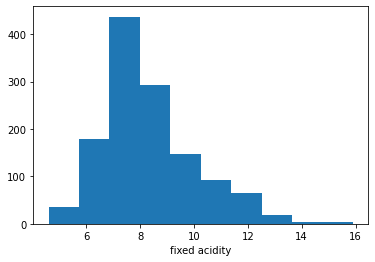

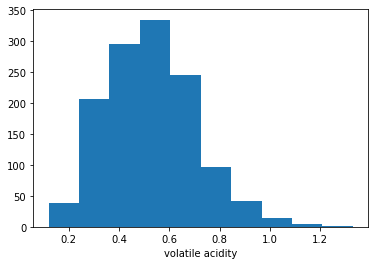

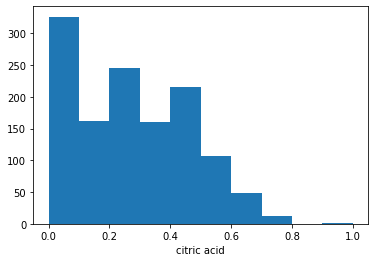

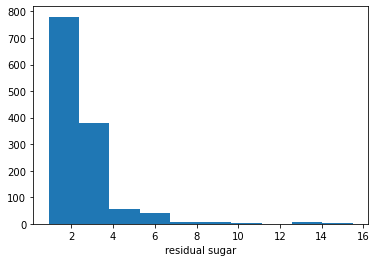

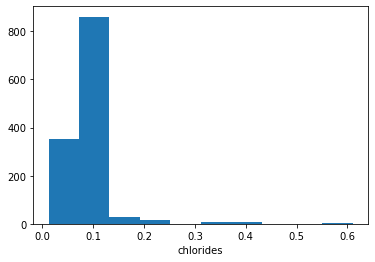

...

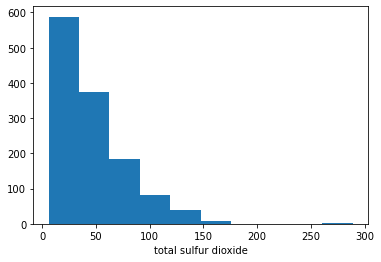

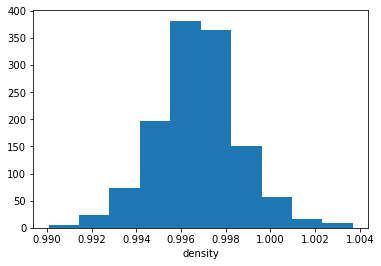

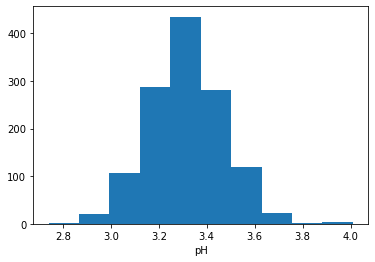

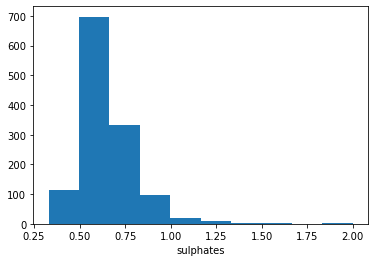

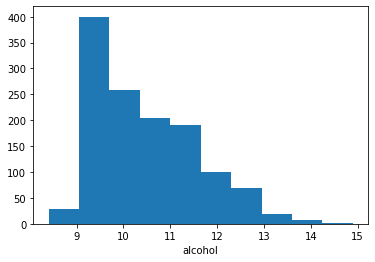

In [16]:
# Plot the histogram of the features.

for col in X_train.columns.values:
    plt.hist(X_train[col])
    plt.xlabel(col)
    plt.show()

#### Observation: All the variables are spread well
#### Next: Plot pair-wise scatter plots

array([[<AxesSubplot:xlabel='fixed acidity', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='volatile acidity', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='citric acid', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='residual sugar', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='chlorides', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='free sulfur dioxide', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='total sulfur dioxide', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='density', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='pH', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='sulphates', ylabel='fixed acidity'>,
        <AxesSubplot:xlabel='alcohol', ylabel='fixed acidity'>],
       [<AxesSubplot:xlabel='fixed acidity', ylabel='volatile acidity'>,
        <AxesSubplot:xlabel='volatile acidity', ylabel='volatile acidity'>,
        <AxesSubplot:xlabel='citric acid', ylabel='volatile acidity'>,
        <AxesSubplot:xlab

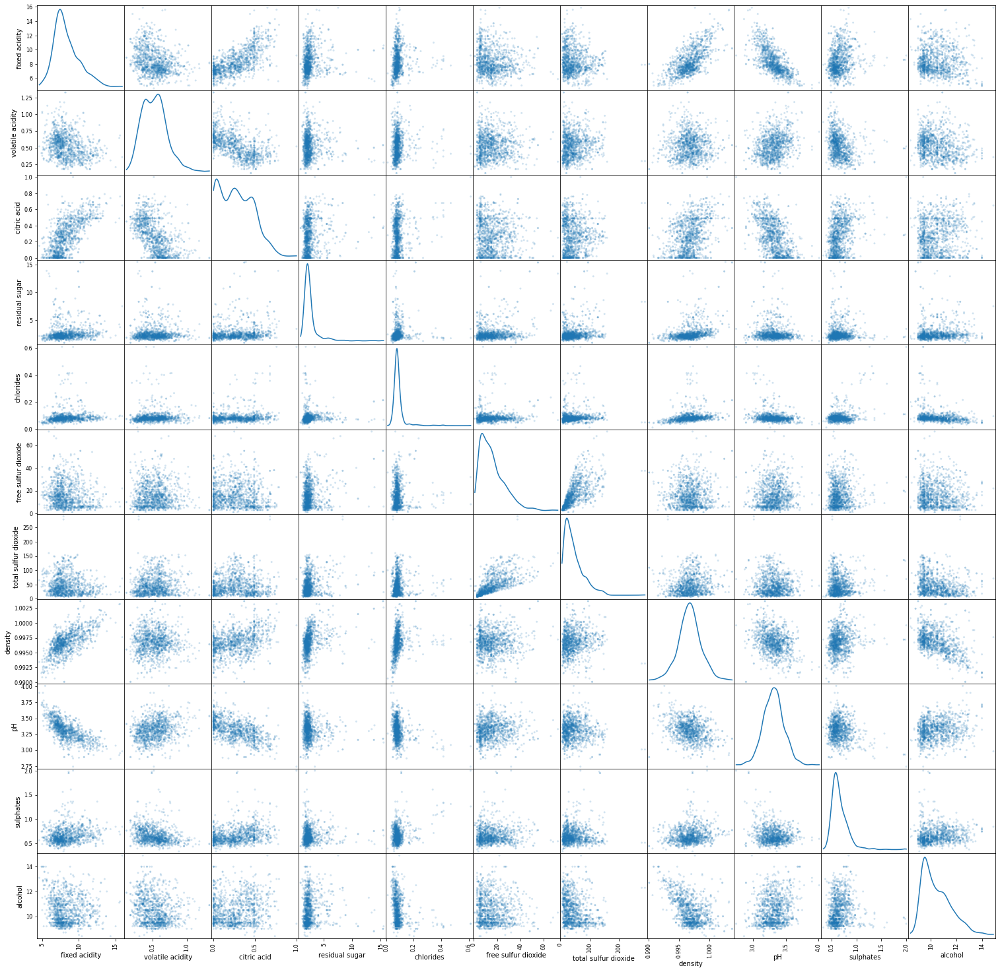

In [17]:
from pandas.plotting import scatter_matrix

scatter_matrix(X_train , alpha= 0.2 , figsize= (26,26) , diagonal='kde')

#### Observation: None of the features are highly corelated with each other
#### Next: We have a look at the corrtelation matrixx

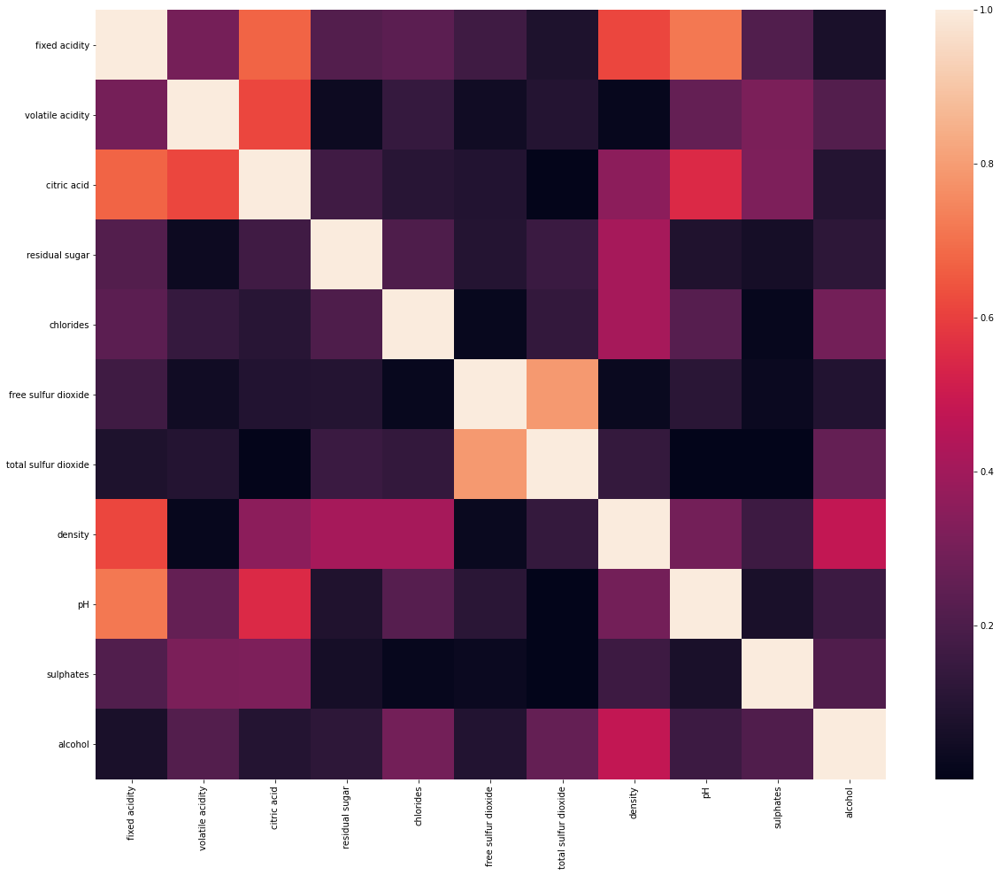

In [18]:
corrMatrix =X_train.corr(method = "spearman")
fig , ax = plt.subplots(figsize = (20,16))
sns.heatmap(abs(corrMatrix) , annot= False) # Show absolute value
plt.show()

#### There isn't much correlation in the features as can be seen above in the correlation matrix. Hence, we continue with all the features

## Prepare data

In [19]:
# Normalize data

from sklearn import preprocessing
scaler = preprocessing.StandardScaler() # For data normalization

features = ["fixed acidity","volatile acidity","citric acid","residual sugar","chlorides","free sulfur dioxide","total sulfur dioxide","density","pH","sulphates","alcohol"]

scaler.fit(X_train[features])    #Compute mean and std
train_X = pd.DataFrame(scaler.transform(X_train[features])) # Use mean and deviation
train_Y = pd.DataFrame(y_train)
display("train_X")
print(train_X.mean)

'train_X'

<bound method DataFrame.mean of             0         1         2         3         4         5         6   \
0    -0.827394  0.066453 -1.177143  0.286867 -0.230616 -0.846886 -0.580795   
1    -1.290037 -0.833836 -0.617055 -0.523445 -0.339674 -0.942941 -0.823403   
2     0.271382  0.966741 -1.380811 -0.590971 -0.405108 -0.750831 -0.823403   
3    -0.538243  0.404061 -0.056968  3.190483 -0.383297  1.938717  2.269853   
4     2.064123 -0.890104  2.132464 -0.185815 -0.208804 -0.366610 -0.671773   
...        ...       ...       ...       ...       ...       ...       ...   
1274 -0.480412  0.882339 -1.024392 -0.050763 -0.645035 -1.038996 -1.126663   
1275  0.097891 -1.959196  1.215957 -0.557208 -0.361485  2.803214  1.269094   
1276  2.411105 -0.383692  1.114123  1.299756 -0.383297  0.978164  0.086378   
1277 -0.538243  0.629133 -1.024392 -0.523445  0.271050 -0.750831 -0.702099   
1278 -0.075600  2.007699 -0.362470 -0.793549 -0.034312 -0.846886 -0.459491   

            7         8        

In [20]:
test_X = pd.DataFrame(scaler.transform(X_test[features]))
test_y = pd.DataFrame(y_test)
display(test_X)
print(test_X.mean())
print(test_y)


,0,1,2,3,4,5,6,7,8,9,10
0,0.040061,0.685401,1.674211,-0.320867,0.532789,-0.366610,1.329746,0.290511,-0.732194,-0.814394,-1.157589
1,0.040061,0.516597,-0.922558,-0.253341,-0.077935,-0.462665,1.875615,-0.185074,-1.055987,0.024020,-0.602062
2,2.121953,-1.396516,1.114123,-0.455919,-0.296051,-0.558720,-0.762751,0.449040,-2.156886,0.024020,-0.509474
3,0.387043,-0.439960,1.114123,0.016763,-0.077935,0.497888,0.874855,1.030310,0.239187,-0.514960,-0.694650
4,-0.364752,-0.552496,-0.107885,0.016763,-0.317862,1.266330,0.510943,-0.317181,0.368704,-0.455073,0.046053
...,...,...,...,...,...,...,...,...,...,...,...
315,-0.596073,0.910473,0.248534,-0.253341,-0.405108,1.842661,1.754311,-0.227348,0.109670,-0.874280,-0.879826
316,-0.596073,-1.115176,1.012289,-0.320867,-0.230616,-1.038996,-1.066011,-0.502130,0.109670,-0.754507,-0.139123
317,1.543650,-1.283980,1.572377,-0.320867,-0.732282,-0.846886,-0.823403,0.660411,-0.019848,1.341528,0.046053
318,-0.191261,1.051143,-0.260636,-0.185815,-0.274239,-0.270554,1.056812,0.068572,-0.473159,-0.694620,-0.879826


0    -0.032046
1    -0.010388
2    -0.005415
3    -0.122721
4    -0.011614
5     0.027967
6     0.047902
7    -0.009388
8    -0.063155
9     0.064631
10   -0.126199
dtype: float64
      quality
304       5.0
111       5.0
583       7.0
592       5.0
228       6.0
...       ...
1572      5.0
150       6.0
209       7.0
1275      6.0
1144      5.0

[320 rows x 1 columns]


In [21]:
## Using the same transformations on the extra data (White)
X2 = pd.DataFrame(scaler.transform(df_test_white[features]))
y2 = pd.DataFrame(df_test_white["quality"])
display(X2)
print(X2.mean())
print(y2)


,0,1,2,3,4,5,6,7,8,9,10
0,-0.769564,-1.452784,0.452202,12.238963,-0.928586,2.803214,3.755829,2.245694,-2.027368,-1.233601,-1.527941
1,-1.174376,-1.283980,0.350368,-0.658497,-0.841339,-0.174499,2.603440,-1.453300,-0.084607,-0.994054,-0.879826
2,-0.133430,-1.396516,0.655870,2.920379,-0.819528,1.362385,1.542028,-0.872030,-0.343641,-1.293487,-0.324299
3,-0.653903,-1.677856,0.248534,4.000795,-0.645035,2.995324,4.241046,-0.607816,-0.796953,-1.533034,-0.509474
4,-0.653903,-1.677856,0.248534,4.000795,-0.645035,2.995324,4.241046,-0.607816,-0.796953,-1.533034,-0.509474
...,...,...,...,...,...,...,...,...,...,...,...
4893,-1.232207,-1.790392,0.095783,-0.658497,-1.059455,0.786053,1.390398,-2.964603,-0.278883,-0.934167,0.694167
4894,-1.000885,-1.171444,0.452202,3.663165,-0.884963,3.955877,3.695177,-0.977715,-1.055987,-1.173714,-0.787238
4895,-1.058716,-1.621588,-0.413387,-0.928601,-1.015832,1.362385,1.966593,-2.224805,-2.092127,-1.173714,-0.972414
4896,-1.637019,-1.340248,0.146700,-0.996127,-1.430251,0.401832,1.936267,-4.259251,0.174428,-1.652808,2.175573


0    -0.853541
1    -1.406413
2     0.320793
3     2.576952
4    -0.911739
5     1.872254
6     2.796333
7    -1.438834
8    -0.808178
9    -0.994971
10    0.059262
dtype: float64
      quality
0         6.0
1         6.0
2         6.0
3         6.0
4         6.0
...       ...
4893      6.0
4894      5.0
4895      6.0
4896      7.0
4897      6.0

[4898 rows x 1 columns]


## Rigorous training and validation

### 1) Lasso Regression

 In the following Lasso regression model, we use Cross-validation for hyperparameter tuning of the parameter alpha. 
 Interpretation of the hyperparameter: Lasso introduces bias into ordinary least squares to combat overfitting. The hyperparameter in this equation is denoted by λ (lambda). A larger value chosen for λ will result in a greater quantity of bias introduced into the algorithm’s output. In the model, this hyperparameter lambda is named as "alpha"
 We use GridSearchCV for cross validating. 
 The scoring function used here is "R squared"
 R-squared: R Squared is a measurement that tells you to what extent the proportion of variance in the dependent variable is explained by the variance in the independent variables. In simpler terms, while the coefficients estimate trends, R-squared represents the scatter around the line of best fit. For example, if the R² is 0.80, then 80% of the variation can be explained by the model’s inputs. If the R² is 1.0 or 100%, that means that all movements of the dependent variable can be entirely explained by the movements of the independent variables. 

In [23]:
from sklearn.model_selection import GridSearchCV

scoring = 'r2'

from sklearn.linear_model import Lasso
grid = dict()
grid['alpha'] = np.arange(0,1,0.01) 
model = Lasso()
reg_lasso = GridSearchCV(model, param_grid = grid , scoring= scoring)
reg_lasso.fit(train_X, train_Y)
print('Best parameters: '+str(reg_lasso.best_params_))
print("Best score for "+ scoring+": " +str(reg_lasso.best_score_))


Best parameters: {'alpha': 0.01}
Best score for r2: 0.351278778240346


In [24]:
print("Test Regression Report: ")
y_true, y_pred = np.squeeze(test_y) , np.array(reg_lasso.predict(np.array(test_X))).flatten()


## As y_pred should be a discrete value (as quality did not take values other than natural numbers), we round off the obtained y_pred
y_pred = np.round(y_pred)

## Obtaining the score of the model on the data
from sklearn.metrics import r2_score
print("The R-squared score of our model on the test data is "+str(r2_score(y_true, y_pred)))

Test Regression Report: 
The R-squared score of our model on the test data is 0.16577067530746004


### Using the same model on the extra dataset (White)

In [25]:
print("Test Regression Report: ")
y_true, y_pred = np.squeeze(y2) , np.array(reg_lasso.predict(np.array(X2))).flatten()


## As y_pred should be a discrete value (as quality did not take values other than natural numbers), we round off the obtained y_pred
y_pred = np.round(y_pred)

## Obtaining the score of the model on the data
from sklearn.metrics import r2_score
print("The R-squared score of our model on the test data is "+str(r2_score(y_true, y_pred)))

Test Regression Report: 
The R-squared score of our model on the test data is 0.04503781606585333


Observation: Hence, we can easily see that our model on red dataset doesn not perform well on white dataset

### RFECV for Lasso Regression

In [38]:
from sklearn.feature_selection import RFECV

reg_lasso_rfecv = Lasso()
rfecv = RFECV(estimator = reg_lasso_rfecv , step = 1 , cv = 5, scoring = 'r2')
rfecv = rfecv.fit(train_X , train_Y)
print("Optimal number of features : ", rfecv.n_features_)
print("Best features : ", train_X.columns[rfecv.support_])

Optimal number of features :  1
Best features :  Int64Index([10], dtype='int64')


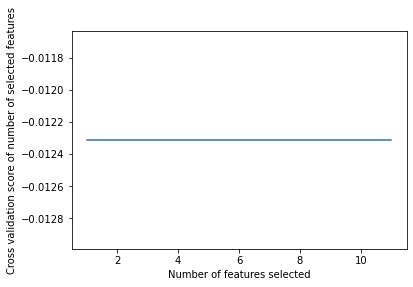

In [39]:
plt.figure()
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score of number of selected features")
plt.plot(range(1,len(rfecv.grid_scores_)+1), rfecv.grid_scores_)
plt.show()

In [40]:
#### Now, let us look at the performance of our model with these features
train_X_rfecv = rfecv.transform(train_X)
test_X_rfecv = rfecv.transform(test_X)

In [43]:
reg_lasso_rfecv = reg_lasso_rfecv.fit(train_X_rfecv,train_Y)

print("Test Regression Report: ")
y_true, y_pred = np.squeeze(test_y) , np.array(reg_lasso_rfecv.predict(np.array(test_X_rfecv))).flatten()


## As y_pred should be a discrete value (as quality did not take values other than natural numbers), we round off the obtained y_pred
y_pred = np.round(y_pred)

## Obtaining the score of the model on the data
from sklearn.metrics import r2_score
print("The R-squared score of our model on the test data is "+str(abs(r2_score(y_true, y_pred))))

Test Regression Report: 
The R-squared score of our model on the test data is 0.23013476691950796


#### Hence, by feature elimination we have obtained a slighly better score.

### SVR (Support Vector Regression)
 SVR is a powerful algorithm that allows us to choose how tolerant we are of errors, both through an acceptable error margin(ϵ) and through tuning our tolerance of falling outside that acceptable error rate. SVR gives us the flexibility to define how much error is acceptable in our model and will find an appropriate line (or hyperplane in higher dimensions) to fit the data.
 The objective function of SVR is to minimize the coefficients — more specifically, the l2-norm of the coefficient vector — not the squared error. The hyperparametersthat are tuned in SVR in the following model are:
 1) Kernel : The function used to map a lower dimensional data into a higher dimensional data. There are various types of kernels like radial basis function (rbf), linear, gaussian, etc.
 2) C: The Penalty Parameter. It tells the algorithm how much you care about misclassified points.
 3) Degree: It is the degree of the polynomial kernel function ('poly') and is ignored by all other kernels. The default value is 3. 

 We use GridSearchCV for cross validating. 
 The scoring function used here is "R squared"
 R-squared: R Squared is a measurement that tells you to what extent the proportion of variance in the dependent variable is explained by the variance in the independent variables. In simpler terms, while the coefficients estimate trends, R-squared represents the scatter around the line of best fit. For example, if the R² is 0.80, then 80% of the variation can be explained by the model’s inputs. If the R² is 1.0 or 100%, that means that all movements of the dependent variable can be entirely explained by the movements of the independent variables. 

In [31]:
## First we will use an automated grid-search over renge of hyperparameters.

from sklearn.model_selection import GridSearchCV

print("Training SVR using GridSearchCV")
scoring = 'r2'

from sklearn import svm
hyperparameters = {'kernel':('rbf' , 'linear' , 'poly') , 'C':[0.1 , 1 , 10], 'degree':[3,5,8]}

svr = svm.SVR()
reg_svr = GridSearchCV(estimator=svr, param_grid = hyperparameters , scoring= scoring)
reg_svr.fit(np.array(train_X) , np.squeeze(train_Y))
print('Best parameters: '+str(reg_svr.best_params_))
print("Best "+ scoring+": " +str(reg_svr.best_score_))


print("Test Regression Report: ")
y_true, y_pred = np.squeeze(test_y) , reg_svr.predict(np.array(test_X))

## As y_pred should be a discrete value (as quality did not take values other than natural numbers), we round off the obtained y_pred
y_pred = np.round(y_pred)

## Obtaining the score of the model on the data
from sklearn.metrics import r2_score
print("The R-squared score of our model on the test data is "+str(abs(r2_score(y_true, y_pred))))

Training SVR using GridSearchCV
Best parameters: {'C': 1, 'degree': 3, 'kernel': 'rbf'}
Best r2: 0.3924904837236001
Test Regression Report: 
The R-squared score of our model on the test data is 0.17991015538699462


The R-squared score obtained here was unexpectedly low. However, while experimenting with the hyperparameters I had got a higher R-squred score on the prediction. However, I am unable to pin-point the exact source for getting low R-squared score in this model. 

### Using the same model on the extra dataset (White)

In [28]:
print("Test Regression Report: ")
y_true, y_pred = np.squeeze(y2) , np.array(reg_svr.predict(np.array(X2))).flatten()


## As y_pred should be a discrete value (as quality did not take values other than natural numbers), we round off the obtained y_pred
y_pred = np.round(y_pred)

## Obtaining the score of the model on the data
from sklearn.metrics import r2_score
print("The R-squared score of our model on the test data is "+str(r2_score(y_true, y_pred)))

Test Regression Report: 
The R-squared score of our model on the test data is 0.009630275985416104


#### Observation: Hence, we can easily see that our model on red dataset doesn not perform well on white dataset

## Random Forest Regression

 Random forests or random decision forests are an ensemble learning method for classification, regression and other tasks that operate by constructing a multitude of decision trees at training time and outputting the class that is the mode of the classes (classification) or mean/average prediction (regression) of the individual trees.
 The hyperparameters that are tuned in the following model are:
 1) max_depth : The max_depth of a tree in Random Forest is defined as the longest path between the root node and the leaf node: Using the max_depth parameter, I can limit up to what depth I want every tree in my random forest to grow
 2) n_estimators : This is the number of trees you want to build before taking the maximum voting or averages of predictions. Higher number of trees give you better performance but makes your code slower.

 We use GridSearchCV for cross validating. 
 The scoring function used here is "R squared"
 R-squared: R Squared is a measurement that tells you to what extent the proportion of variance in the dependent variable is explained by the variance in the independent variables. In simpler terms, while the coefficients estimate trends, R-squared represents the scatter around the line of best fit. For example, if the R² is 0.80, then 80% of the variation can be explained by the model’s inputs. If the R² is 1.0 or 100%, that means that all movements of the dependent variable can be entirely explained by the movements of the independent variables. 

In [29]:
from sklearn.model_selection import GridSearchCV

print("Training Random Forest Regressor using GridSearchCV")
scoring = 'r2'

from sklearn.ensemble import RandomForestRegressor

rfr = RandomForestRegressor()
hyperparameters = {'max_depth':[2,5,10,20,40,100] , 'n_estimators':[10,30,80,100,130,170,200]}
reg_rfr = GridSearchCV(estimator=rfr, param_grid = hyperparameters , scoring= scoring)
reg_rfr.fit(np.array(train_X) , np.squeeze(train_Y))
print('Best parameters: '+str(reg_rfr.best_params_))
print("Best "+ scoring+": " +str(reg_rfr.best_score_))


print("Test Regression Report: ")
y_true, y_pred = np.squeeze(test_y) , reg_rfr.predict(np.array(test_X))

## As y_pred should be a discrete value (as quality did not take values other than natural numbers), we round off the obtained y_pred
y_pred = np.round(y_pred)

## Obtaining the score of the model on the data
from sklearn.metrics import r2_score
print("The R-squared score of our model on the test data is "+str(abs(r2_score(y_true, y_pred))))

Training Random Forest Regressor using GridSearchCV
Best parameters: {'max_depth': 20, 'n_estimators': 170}
Best r2: 0.45980347683673717
Test Regression Report: 
The R-squared score of our model on the test data is 0.3401575962883865


### Using the same model on the extra dataset (White)

In [30]:
print("Test Regression Report: ")
y_true, y_pred = np.squeeze(y2) , np.array(reg_rfr.predict(np.array(X2))).flatten()


## As y_pred should be a discrete value (as quality did not take values other than natural numbers), we round off the obtained y_pred
y_pred = np.round(y_pred)

## Obtaining the score of the model on the data
from sklearn.metrics import r2_score
print("The R-squared score of our model on the test data is "+str(r2_score(y_true, y_pred)))

Test Regression Report: 
The R-squared score of our model on the test data is -0.010416640089537355


Observation: Hence, we can easily see that our model on red dataset doesn not perform well on white dataset